In [1]:
import pandas as pd

In [2]:
import numpy as np

In [3]:
df = pd.read_excel('/Users/shivendragupta/Desktop/internship25/Marketing ML/data/hist.xlsx')

In [4]:
df_for_estimating = pd.read_excel('/Users/shivendragupta/Desktop/internship25/Marketing ML/data/hist.xlsx')

In [5]:
df.head()

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response
0,1,1,B,2,M,1,1
1,1,2,A,38,F,2,0
2,1,3,C,46,M,3,0
3,1,4,B,35,M,4,0
4,1,5,B,22,M,5,1


In [6]:
df.shape

(260000, 7)

In [7]:
# EDA

# ```Campaign wise response rates```

In [8]:
for i in range(1,11):
    total_response_rate = df[df['campaign_id']==i]['response'].mean()
    print(f'Campaign {i} - Total Response Rate: {total_response_rate:.2%}')

Campaign 1 - Total Response Rate: 49.21%
Campaign 2 - Total Response Rate: 42.04%
Campaign 3 - Total Response Rate: 32.88%
Campaign 4 - Total Response Rate: 50.18%
Campaign 5 - Total Response Rate: 37.45%
Campaign 6 - Total Response Rate: 49.00%
Campaign 7 - Total Response Rate: 48.83%
Campaign 8 - Total Response Rate: 31.07%
Campaign 9 - Total Response Rate: 36.20%
Campaign 10 - Total Response Rate: 47.58%


# ```Weekly Response Rate```

<Axes: title={'center': 'Weekly Response Rate'}, xlabel='week_id'>

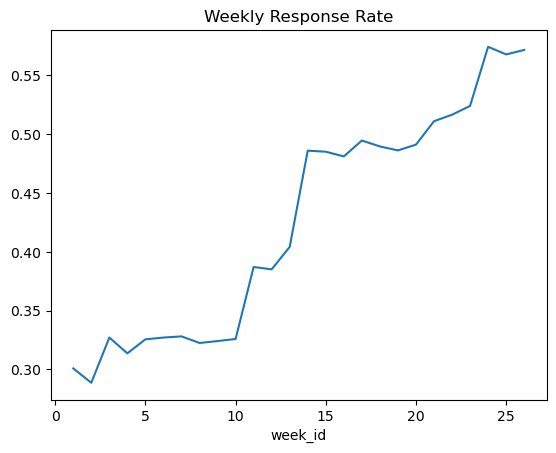

In [9]:
weekly_response = df.groupby('week_id')['response'].mean()
weekly_response.plot(title='Weekly Response Rate')

# ```Category wise Response Rate```

In [10]:
category_response = df.groupby('attribute1')['response'].mean()
print(category_response)


attribute1
A    0.556955
B    0.210021
C    0.654000
D    0.339282
Name: response, dtype: float64


# ```StateWise Response Rate```

In [11]:
state_response = df.groupby('state_id')['response'].mean().sort_values(ascending=False)
print(state_response.head())


state_id
17    0.461337
16    0.458551
50    0.450484
2     0.447552
32    0.445228
Name: response, dtype: float64


# ```Top responders```

In [12]:
# Calculate each customer's average response rate
consumer_response_rate = df.groupby('customer_id')['response'].mean()

# Sort to find top responders
top_responders = consumer_response_rate.sort_values(ascending=False)

# Display top 10
print(top_responders.head(500))




customer_id
388     1.000000
554     1.000000
829     1.000000
46      1.000000
6454    1.000000
          ...   
8496    0.807692
6518    0.807692
8497    0.807692
6504    0.807692
6206    0.807692
Name: response, Length: 500, dtype: float64


In [13]:
top_ids = top_responders.head(500).index.tolist()

In [14]:
top_ids

[388,
 554,
 829,
 46,
 6454,
 13094,
 4339,
 1008,
 4038,
 6989,
 8489,
 3990,
 2378,
 1919,
 9186,
 5732,
 8730,
 8944,
 5140,
 2143,
 8348,
 5117,
 1740,
 2587,
 7556,
 1537,
 7535,
 124,
 115,
 12584,
 7665,
 3125,
 12704,
 13106,
 8921,
 4830,
 2923,
 12667,
 4717,
 1010,
 4490,
 3322,
 1016,
 1169,
 4053,
 3378,
 1180,
 1129,
 1131,
 4982,
 3720,
 3871,
 5652,
 4983,
 6752,
 7882,
 8014,
 8030,
 8120,
 8121,
 7608,
 7575,
 7427,
 8235,
 8273,
 8338,
 7140,
 6770,
 8476,
 886,
 6687,
 6531,
 690,
 8525,
 6294,
 775,
 5863,
 5843,
 5819,
 5656,
 2675,
 5645,
 5481,
 2788,
 7964,
 2370,
 2222,
 1905,
 2421,
 2336,
 1500,
 1541,
 1830,
 1633,
 13085,
 1977,
 12982,
 1989,
 2295,
 1510,
 936,
 5755,
 5432,
 5311,
 4623,
 9061,
 1713,
 7180,
 6307,
 4602,
 5718,
 4598,
 1936,
 4579,
 9103,
 5768,
 1406,
 29,
 804,
 1401,
 2651,
 17,
 4310,
 9170,
 7250,
 2052,
 5769,
 1399,
 4231,
 1530,
 1759,
 6556,
 13082,
 8701,
 6624,
 5453,
 5042,
 6867,
 6734,
 5511,
 12937,
 5180,
 2283,
 8969,

In [15]:
df[df['customer_id'].isin(top_ids)].groupby(['attribute1', 'state_id', 'Sex']).size().sort_values(ascending=False)


attribute1  state_id  Sex
C           4         F      234
            36        F      234
            6         F      234
A           16        M      208
            43        M      208
                            ... 
            49        F       26
C           29        M       26
            17        M       26
D           4         F       26
C           11        F       26
Length: 155, dtype: int64

In [16]:
df['response'].mean()

0.4244538461538462

In [17]:
top_df = df[df['customer_id'].isin(top_ids)]

<Axes: title={'center': 'Weekly Response Rate of Top Responders'}, xlabel='week_id'>

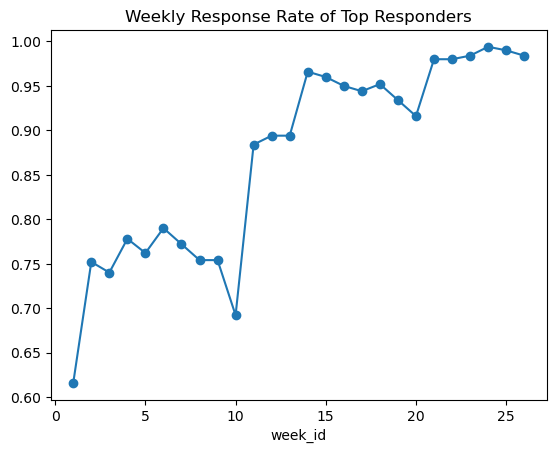

In [18]:
weekly_pattern = top_df.groupby('week_id')['response'].mean()
weekly_pattern.plot(title='Weekly Response Rate of Top Responders', marker='o')

In [19]:
df.groupby(['attribute1', 'campaign_id'])['response'].mean().unstack().style.background_gradient(cmap='Blues')


campaign_id,1,2,3,4,5,6,7,8,9,10
attribute1,,,,,,,,,,
A,0.619340,0.569219,0.439233,0.647642,0.496449,0.639754,0.623086,0.427905,0.484577,0.622620
B,0.303778,0.200518,0.096783,0.296575,0.156886,0.289695,0.284547,0.072753,0.126149,0.272798
C,0.709094,0.654376,0.566991,0.726643,0.609812,0.714879,0.712093,0.545371,0.607777,0.693335
D,0.393719,0.325545,0.275279,0.399938,0.296469,0.378172,0.393430,0.260150,0.293060,0.376421


In [20]:
df.sample(4)

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response
121921,13,1922,C,6,F,4,1
251550,26,1551,D,38,M,6,1
257971,26,7972,D,33,M,7,0
104310,11,4311,D,43,M,1,0


In [21]:
df.nunique()

week_id           26
customer_id    10000
attribute1         4
state_id          50
Sex                2
campaign_id       10
response           2
dtype: int64

In [22]:
# Previous Campaigns sent

In [23]:
previous_campaigns = []
df_lookup = df.set_index(['customer_id', 'week_id'])

In [24]:
for _, row in df.iterrows():
    cust = row['customer_id']
    week = row['week_id']
    
    # Use .loc with try-except to get previous week's campaign
    try:
        prev_campaign = df_lookup.loc[(cust, week - 1), 'campaign_id']
    except KeyError:
        prev_campaign = None
    
    previous_campaigns.append(prev_campaign)

# Add the result back to the original DataFrame
df['previous_week_campaign_sent'] = previous_campaigns

In [25]:
df.sample(4)

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response,previous_week_campaign_sent
192583,20,2584,D,48,F,3,1,2.0
40440,5,441,B,1,F,5,0,4.0
126299,13,6300,B,28,M,2,0,1.0
108853,11,8854,C,46,M,4,1,3.0


In [26]:
# Lifetime Value response rate

In [27]:
# Group by customer and calculate lifetime response rate
response_rate_per_customer = df.groupby('customer_id')['response'].mean().rename('lifetime_response_rate')

# Merge it back to the original DataFrame
df = df.merge(response_rate_per_customer, on='customer_id', how='left')

In [28]:
df.sample(4)

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response,previous_week_campaign_sent,lifetime_response_rate
238176,24,8177,B,18,F,10,0,9.0,0.192308
169051,17,9052,D,22,M,8,0,7.0,0.076923
145110,15,5111,A,28,M,5,1,4.0,0.538462
182286,19,2287,C,38,F,5,1,4.0,0.846154


In [29]:
# previous week response 

In [30]:
# Create lookup dataframe: response history per (customer, week)
lookup = df.set_index(['customer_id', 'week_id'])['response']

# Result list
previous_week_response = []

# Go row-by-row
for _, row in df.iterrows():
    cust = row['customer_id']
    week = row['week_id']
    
    try:
        resp = lookup.loc[(cust, week - 1)]
    except KeyError:
        resp = None
        
    previous_week_response.append(resp)

# Now you can inspect or use this Series without modifying original df
df['previous_week_response'] = previous_week_response


In [31]:
df.sample(4)

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response
57632,6,7633,C,32,M,8,0,7.0,0.500000,0.0
35891,4,5892,D,42,F,5,0,4.0,0.461538,0.0
157707,16,7708,B,22,F,3,0,2.0,0.192308,0.0
44961,5,4962,C,9,F,6,1,5.0,0.538462,0.0


In [32]:
# Number of weeks since last response

In [33]:

# Sort by customer and week to ensure proper sequence
df = df.sort_values(by=['customer_id', 'week_id']).reset_index(drop=True)

# Tracker: last week when customer responded
last_response_week = {}

# Output list
weeks_since_last_response = []

# Compute WEEK_SINCE_LAST_RESPONSE
for _, row in df.iterrows():
    cust = row['customer_id']
    current_week = row['week_id']
    
    # Get last response week
    last_week = last_response_week.get(cust)
    
    # Calculate gap
    if last_week is None:
        weeks_since = None
    else:
        weeks_since = current_week - last_week
    
    weeks_since_last_response.append(weeks_since)
    
    # Update if this row is a response
    if row['response'] == 1:
        last_response_week[cust] = current_week

# Add column (optional)
df['WEEK_SINCE_LAST_RESPONSE'] = weeks_since_last_response


In [34]:
df = df.sort_values(by=['week_id', 'customer_id']).reset_index(drop=True)

In [35]:
df.head()

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE
0,1,1,B,2,M,1,1,NaN,0.230769,NaN,NaN
1,1,2,A,38,F,2,0,NaN,0.384615,NaN,NaN
2,1,3,C,46,M,3,0,NaN,0.538462,NaN,NaN
3,1,4,B,35,M,4,0,NaN,0.038462,NaN,NaN
4,1,5,B,22,M,5,1,NaN,0.153846,NaN,NaN


In [36]:
df['previous_week_campaign_sent'] = df['previous_week_campaign_sent'].fillna(-1).astype(int)

In [37]:
df.head()

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE
0,1,1,B,2,M,1,1,-1,0.230769,NaN,NaN
1,1,2,A,38,F,2,0,-1,0.384615,NaN,NaN
2,1,3,C,46,M,3,0,-1,0.538462,NaN,NaN
3,1,4,B,35,M,4,0,-1,0.038462,NaN,NaN
4,1,5,B,22,M,5,1,-1,0.153846,NaN,NaN


In [38]:
df['previous_week_response'] = df['previous_week_response'].fillna(0).astype(int)

In [39]:
df_for_estimating = df.copy()

In [40]:
df.head()

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE
0,1,1,B,2,M,1,1,-1,0.230769,0,NaN
1,1,2,A,38,F,2,0,-1,0.384615,0,NaN
2,1,3,C,46,M,3,0,-1,0.538462,0,NaN
3,1,4,B,35,M,4,0,-1,0.038462,0,NaN
4,1,5,B,22,M,5,1,-1,0.153846,0,NaN


In [41]:
df.isnull().sum()

week_id                            0
customer_id                        0
attribute1                         0
state_id                           0
Sex                                0
campaign_id                        0
response                           0
previous_week_campaign_sent        0
lifetime_response_rate             0
previous_week_response             0
WEEK_SINCE_LAST_RESPONSE       53888
dtype: int64

In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260000 entries, 0 to 259999
Data columns (total 11 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   week_id                      260000 non-null  int64  
 1   customer_id                  260000 non-null  int64  
 2   attribute1                   260000 non-null  object 
 3   state_id                     260000 non-null  int64  
 4   Sex                          260000 non-null  object 
 5   campaign_id                  260000 non-null  int64  
 6   response                     260000 non-null  int64  
 7   previous_week_campaign_sent  260000 non-null  int64  
 8   lifetime_response_rate       260000 non-null  float64
 9   previous_week_response       260000 non-null  int64  
 10  WEEK_SINCE_LAST_RESPONSE     206112 non-null  float64
dtypes: float64(2), int64(7), object(2)
memory usage: 21.8+ MB


In [43]:
def discretize_weeks_since_last_response(x):
    if pd.isna(x):
        return 1
    elif x == 1:
        return 2
    elif x == 2:
        return 3
    elif x == 3:
        return 4
    elif 4 <= x <= 5:
        return 5
    elif x >= 6:
        return 6

# Apply the function
df['WEEK_SINCE_LAST_RESPONSE_CAT'] = df['WEEK_SINCE_LAST_RESPONSE'].apply(discretize_weeks_since_last_response).astype('int')


In [44]:
df.drop(columns=['WEEK_SINCE_LAST_RESPONSE'], inplace=True)

In [45]:
from sklearn.preprocessing import OneHotEncoder

In [46]:
df['campaign_id'] = df['campaign_id'].astype(object)

In [47]:
categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

In [48]:
categorical_cols

['attribute1', 'Sex', 'campaign_id']

In [49]:
ohe = OneHotEncoder(handle_unknown='ignore', sparse_output=False, drop='first')
ohe_train = pd.DataFrame(
    ohe.fit_transform(df[categorical_cols]),
    columns=ohe.get_feature_names_out(categorical_cols),
    index=df.index
)


In [50]:
ohe_train

,attribute1_B,attribute1_C,attribute1_D,Sex_M,campaign_id_2,campaign_id_3,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10
0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
259995,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259996,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259997,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259998,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [51]:
df.shape

(260000, 11)

In [67]:
df = df.drop(columns=categorical_cols)

In [68]:
df = df.merge(ohe_train, left_index=True, right_index=True)

In [69]:
df.head()

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,Sex_M,campaign_id_2,campaign_id_3,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10
0,1,1,2,1,-1,0.230769,0,1,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,2,38,0,-1,0.384615,0,1,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1,3,46,0,-1,0.538462,0,1,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1,4,35,0,-1,0.038462,0,1,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1,5,22,1,-1,0.153846,0,1,1.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [70]:
df.shape

(260000, 21)

In [71]:
# Train on weeks 1 to 23
train_df = df[df['week_id'] <= 23].copy()

# Test on weeks 24 to 26
test_df = df[df['week_id'] >= 24].copy()


In [72]:
train_df.shape,test_df.shape

((230000, 21), (30000, 21))

In [73]:
train_x , train_y = train_df.drop(columns=['response','week_id','customer_id','state_id']), train_df['response']

In [74]:
test_x , test_y = test_df.drop(columns=['response','week_id','customer_id','state_id']), test_df['response']

In [75]:
train_x

,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,attribute1_D,Sex_M,campaign_id_2,campaign_id_3,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10
0,-1,0.230769,0,1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,-1,0.384615,0,1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,-1,0.538462,0,1,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-1,0.038462,0,1,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,-1,0.153846,0,1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229995,7,0.500000,1,2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
229996,8,0.461538,0,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
229997,9,0.653846,0,3,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
229998,10,0.576923,1,2,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [76]:
test_x

,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,attribute1_D,Sex_M,campaign_id_2,campaign_id_3,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10
230000,3,0.230769,0,5,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
230001,4,0.384615,0,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
230002,5,0.538462,1,2,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
230003,6,0.038462,0,6,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
230004,7,0.153846,0,6,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259995,10,0.500000,0,3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259996,1,0.461538,0,3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259997,2,0.653846,1,2,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259998,3,0.576923,1,2,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [77]:
from sklearn.linear_model import LogisticRegression

In [78]:
lr = LogisticRegression()

In [79]:
lr.fit(train_x, train_y)

LogisticRegression()

In [80]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score,classification_report

In [81]:
accuracy_score(test_y, lr.predict(test_x))

0.751

In [82]:
from sklearn.ensemble import RandomForestClassifier

In [83]:
rf = RandomForestClassifier(n_estimators=100, random_state=42)

In [84]:
rf.fit(train_x, train_y)

RandomForestClassifier(random_state=42)

In [85]:
accuracy_score_rf = accuracy_score(test_y, rf.predict(test_x))

In [86]:
accuracy_score_rf

0.7749

In [166]:
from xgboost import XGBClassifier
model = XGBClassifier(
    n_estimators=200,
    max_depth=30,
    learning_rate=0.2,
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)
model.fit(train_x, train_y)

/opt/anaconda3/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [20:15:30] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, feature_weights=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=30, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=200, n_jobs=None,
              num_parallel_tree=None, ...)

In [167]:
accuracy_score(test_y, model.predict(test_x))

0.7745666666666666

In [168]:
from sklearn.ensemble import GradientBoostingClassifier
gb = GradientBoostingClassifier(n_estimators=200, max_depth=30, learning_rate=0.2, random_state=42)
gb.fit(train_x, train_y)

GradientBoostingClassifier(learning_rate=0.2, max_depth=30, n_estimators=200,
                           random_state=42)

In [169]:
accuracy_score(test_y, gb.predict(test_x))

0.7709666666666667

In [170]:
# Adding additional features

In [171]:
df.head()

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,Sex_M,campaign_id_2,campaign_id_3,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10
0,1,1,2,1,-1,0.230769,0,1,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,2,38,0,-1,0.384615,0,1,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1,3,46,0,-1,0.538462,0,1,0.0,1.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1,4,35,0,-1,0.038462,0,1,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1,5,22,1,-1,0.153846,0,1,1.0,0.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [172]:
# Number of responses in last 2 weeks

In [173]:
# Create lookup DataFrame indexed by (customer_id, week_id)
df_lookup = df.set_index(['customer_id', 'week_id'])['response']

# List to store results
responses_last_2_weeks = []

# Loop over rows in original DataFrame
for _, row in df.iterrows():
    cust = row['customer_id']
    week = row['week_id']
    
    # Try to get response at week-1 and week-2
    r1 = df_lookup.get((cust, week - 1), 0)
    r2 = df_lookup.get((cust, week - 2), 0)
    
    total = r1 + r2
    responses_last_2_weeks.append(total)

# Add new feature
df['Number_RESPONSE_LAST_2_WEEKS'] = responses_last_2_weeks

In [174]:
df.head()

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_2,campaign_id_3,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS
0,1,1,2,1,-1,0.230769,0,1,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,1,2,38,0,-1,0.384615,0,1,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,1,3,46,0,-1,0.538462,0,1,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,1,4,35,0,-1,0.038462,0,1,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,1,5,22,1,-1,0.153846,0,1,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0


In [175]:
# Number of responses in last 3 weeks

In [176]:
# Create lookup DataFrame indexed by (customer_id, week_id)
df_lookup = df.set_index(['customer_id', 'week_id'])['response']

# List to store results
responses_last_3_weeks = []

# Loop over rows in original DataFrame
for _, row in df.iterrows():
    cust = row['customer_id']
    week = row['week_id']
    
    # Try to get response at week-1 and week-2
    r1 = df_lookup.get((cust, week - 1), 0)
    r2 = df_lookup.get((cust, week - 2), 0)
    r3 = df_lookup.get((cust, week - 3), 0)

    total = r1 + r2 + r3
    responses_last_3_weeks.append(total)

# Add new feature
df['Number_RESPONSE_LAST_3_WEEKS'] = responses_last_3_weeks

In [177]:
# Number of responses in last 4 weeks

In [178]:
# Create lookup DataFrame indexed by (customer_id, week_id)
df_lookup = df.set_index(['customer_id', 'week_id'])['response']

# List to store results
responses_last_4_weeks = []

# Loop over rows in original DataFrame
for _, row in df.iterrows():
    cust = row['customer_id']
    week = row['week_id']
    
    # Try to get response at week-1 and week-2
    r1 = df_lookup.get((cust, week - 1), 0)
    r2 = df_lookup.get((cust, week - 2), 0)
    r3 = df_lookup.get((cust, week - 3), 0)
    r4 = df_lookup.get((cust, week - 4), 0)

    total = r1 + r2 + r3 + r4
    responses_last_4_weeks.append(total)

# Add new feature
df['Number_RESPONSE_LAST_4_WEEKS'] = responses_last_4_weeks

In [179]:
df.sample(4)

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS
70692,8,693,23,1,9,0.730769,0,3,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1,2,3
228417,23,8418,3,1,9,0.730769,1,2,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2,3,4
73762,8,3763,29,0,9,0.038462,0,1,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0
32334,4,2335,15,0,7,0.500000,0,4,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,1,1


In [180]:
df.shape

(260000, 24)

In [181]:
train_x_ = df[df['week_id'] <= 23].drop(columns=['response', 'week_id', 'customer_id', 'state_id'])
train_y_ = df[df['week_id'] <= 23]['response']
test_x_ = df[df['week_id'] >= 24].drop(columns=['response', 'week_id', 'customer_id', 'state_id'])
test_y_ = df[df['week_id'] >= 24]['response']

In [182]:
test_x_

,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,attribute1_D,Sex_M,campaign_id_2,campaign_id_3,campaign_id_4,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS
230000,3,0.230769,0,5,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,1
230001,4,0.384615,0,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1,1,2
230002,5,0.538462,1,2,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2,2,3
230003,6,0.038462,0,6,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0,0
230004,7,0.153846,0,6,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259995,10,0.500000,0,3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,2,3
259996,1,0.461538,0,3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1,1
259997,2,0.653846,1,2,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,3,3
259998,3,0.576923,1,2,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2,3,4


In [183]:
lr_1 = LogisticRegression()
lr_1.fit(train_x_, train_y_)

LogisticRegression()

In [184]:
accuracy_score(test_y_, lr_1.predict(test_x_))

0.7723666666666666

In [185]:
rf_1 = RandomForestClassifier(n_estimators=100, random_state=42)
rf_1.fit(train_x_, train_y_)

RandomForestClassifier(random_state=42)

In [186]:
accuracy_score(test_y_, rf_1.predict(test_x_))

0.7742333333333333

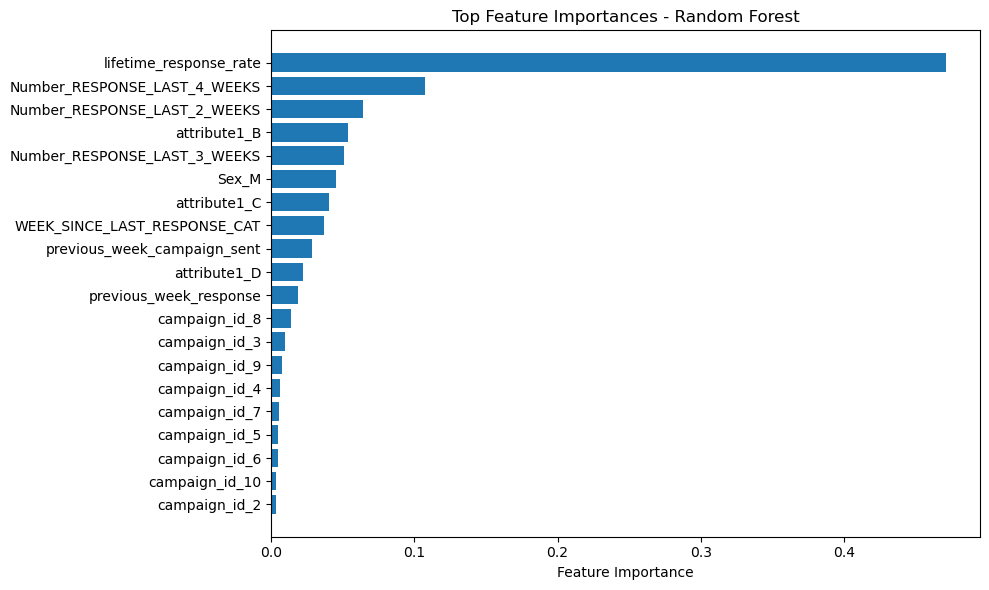

In [187]:
import matplotlib.pyplot as plt
importances = rf_1.feature_importances_
feature_names = train_x_.columns

# Create DataFrame of importances
feat_imp_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

# Plot top N (e.g., top 20) features
top_n = 20
plt.figure(figsize=(10, 6))
plt.barh(feat_imp_df['Feature'].head(top_n)[::-1], feat_imp_df['Importance'].head(top_n)[::-1])
plt.xlabel('Feature Importance')
plt.title('Top Feature Importances - Random Forest')
plt.tight_layout()
plt.show()

In [188]:
gb_2 = GradientBoostingClassifier(n_estimators=200, max_depth=30, learning_rate=0.2, random_state=42)
gb_2.fit(train_x_, train_y_)

GradientBoostingClassifier(learning_rate=0.2, max_depth=30, n_estimators=200,
                           random_state=42)

In [189]:
accuracy_score(test_y_, gb_2.predict(test_x_))

0.7671666666666667

In [190]:
# Adding statewise reponse rate

In [192]:
df_state_wise =  df.groupby('state_id')['response'].mean().reset_index(name='state_response_rate')

In [193]:
df_state_wise

,state_id,state_response_rate
0,1,0.405200
1,2,0.447552
2,3,0.409246
3,4,0.423651
4,5,0.423289
5,6,0.444444
6,7,0.426282
7,8,0.422562
8,9,0.427350
9,10,0.432990


In [194]:
df = df.merge(df_state_wise, on='state_id', how='left')

In [195]:
df.head()

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS,state_response_rate
0,1,1,2,1,-1,0.230769,0,1,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.447552
1,1,2,38,0,-1,0.384615,0,1,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.403156
2,1,3,46,0,-1,0.538462,0,1,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.443340
3,1,4,35,0,-1,0.038462,0,1,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.425668
4,1,5,22,1,-1,0.153846,0,1,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.421957


In [196]:
train_x_ = df[df['week_id'] <= 23].drop(columns=['response', 'week_id', 'customer_id', 'state_id'])
train_y_ = df[df['week_id'] <= 23]['response']
test_x_ = df[df['week_id'] >= 24].drop(columns=['response', 'week_id', 'customer_id', 'state_id'])
test_y_ = df[df['week_id'] >= 24]['response']

In [215]:
train_x_

,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,attribute1_D,Sex_M,campaign_id_2,campaign_id_3,...,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS,state_response_rate
0,-1,0.230769,0,1,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.447552
1,-1,0.384615,0,1,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.403156
2,-1,0.538462,0,1,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.443340
3,-1,0.038462,0,1,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.425668
4,-1,0.153846,0,1,1.0,0.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.421957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229995,7,0.500000,1,2,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1,2,3,0.405200
229996,8,0.461538,0,4,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0,1,1,0.432990
229997,9,0.653846,0,3,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1,2,3,0.405200
229998,10,0.576923,1,2,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2,2,3,0.417308


In [197]:
lr_3 = LogisticRegression()
lr_3.fit(train_x_, train_y_)

LogisticRegression()

In [216]:
accuracy_score(test_y_,lr_3.predict(test_x_))

0.7715333333333333

In [217]:
rf_3 = RandomForestClassifier()

In [218]:
rf_3.fit(train_x_,train_y_)

RandomForestClassifier()

In [219]:
accuracy_score(test_y_,rf_3.predict(test_x_))

0.7594666666666666

In [198]:
df_response_rate = df.groupby('week_id')['response'].mean().reset_index(name='weekly_response_rate')

In [199]:
df_response_rate

,week_id,weekly_response_rate
0,1,0.3009
1,2,0.2887
2,3,0.3271
3,4,0.3137
4,5,0.3256
5,6,0.3271
6,7,0.3281
7,8,0.3225
8,9,0.3241
9,10,0.3259


In [200]:
df_26 = df[df['week_id'] == 26]

In [201]:
df_26

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS,state_response_rate
250000,26,1,2,1,5,0.230769,0,3,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1,1,1,0.447552
250001,26,2,38,1,6,0.384615,1,2,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,2,2,3,0.403156
250002,26,3,46,0,7,0.538462,1,2,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2,3,4,0.443340
250003,26,4,35,0,8,0.038462,0,6,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0,0,0,0.425668
250004,26,5,22,0,9,0.153846,0,6,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0,0.421957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259995,26,13196,1,1,10,0.500000,0,3,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,2,3,0.405200
259996,26,13197,10,1,1,0.461538,0,3,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,1,1,0.432990
259997,26,13198,1,1,2,0.653846,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2,3,3,0.405200
259998,26,13199,27,1,3,0.576923,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2,3,4,0.417308


In [202]:
week_27 = df[df['week_id'] == 26].copy()

In [203]:
week_27['week_id'] = 27

In [204]:
week_27['previous_week_campaign_sent'] = df_for_estimating[df_for_estimating['week_id'] == 26]['campaign_id'].values

In [205]:
week_27['previous_week_response'] = df_for_estimating[df_for_estimating['week_id'] == 26]['response'].values

In [206]:
df_for_estimating[df_for_estimating['week_id'] == 26]

,week_id,customer_id,attribute1,state_id,Sex,campaign_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE
250000,26,1,B,2,M,6,1,5,0.230769,0,2.0
250001,26,2,A,38,F,7,1,6,0.384615,1,1.0
250002,26,3,C,46,M,8,0,7,0.538462,1,1.0
250003,26,4,B,35,M,9,0,8,0.038462,0,18.0
250004,26,5,B,22,M,10,0,9,0.153846,0,9.0
...,...,...,...,...,...,...,...,...,...,...,...
259995,26,13196,A,1,M,1,1,10,0.500000,0,2.0
259996,26,13197,A,10,F,2,1,1,0.461538,0,2.0
259997,26,13198,C,1,M,3,1,2,0.653846,1,1.0
259998,26,13199,C,27,M,4,1,3,0.576923,1,1.0


In [207]:
week_27_WEEK_SINCE_LAST_RESPONSE = []
for _, row in df_for_estimating[df_for_estimating['week_id'] == 26].iterrows():
    week_26_response = row['response']
    week_26_week_since_last_response = row['WEEK_SINCE_LAST_RESPONSE']
    if( week_26_response == 1):
        week_27_WEEK_SINCE_LAST_RESPONSE.append(1)
    else:
        week_27_WEEK_SINCE_LAST_RESPONSE.append(week_26_week_since_last_response + 1)

In [208]:
week_27['WEEK_SINCE_LAST_RESPONSE'] = week_27_WEEK_SINCE_LAST_RESPONSE

In [209]:
week_27

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS,state_response_rate,WEEK_SINCE_LAST_RESPONSE
250000,27,1,2,1,6,0.230769,1,3,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1,1,1,0.447552,1.0
250001,27,2,38,1,7,0.384615,1,2,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,2,2,3,0.403156,1.0
250002,27,3,46,0,8,0.538462,0,2,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,2,3,4,0.443340,2.0
250003,27,4,35,0,9,0.038462,0,6,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0,0,0,0.425668,19.0
250004,27,5,22,0,10,0.153846,0,6,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0,0,0,0.421957,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259995,27,13196,1,1,1,0.500000,1,3,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1,2,3,0.405200,1.0
259996,27,13197,10,1,2,0.461538,1,3,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1,1,1,0.432990,1.0
259997,27,13198,1,1,3,0.653846,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,2,3,3,0.405200,1.0
259998,27,13199,27,1,4,0.576923,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,2,3,4,0.417308,1.0


In [210]:

week_27['WEEK_SINCE_LAST_RESPONSE_CAT'] = week_27['WEEK_SINCE_LAST_RESPONSE'].apply(discretize_weeks_since_last_response).astype('int')

In [211]:
week_27.drop(columns=['WEEK_SINCE_LAST_RESPONSE'] , inplace=True)

In [212]:
week_27

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS,state_response_rate
250000,27,1,2,1,6,0.230769,1,2,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1,1,1,0.447552
250001,27,2,38,1,7,0.384615,1,2,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,2,2,3,0.403156
250002,27,3,46,0,8,0.538462,0,3,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,2,3,4,0.443340
250003,27,4,35,0,9,0.038462,0,6,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0,0,0,0.425668
250004,27,5,22,0,10,0.153846,0,6,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0,0.421957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259995,27,13196,1,1,1,0.500000,1,2,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,2,3,0.405200
259996,27,13197,10,1,2,0.461538,1,2,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,1,1,0.432990
259997,27,13198,1,1,3,0.653846,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2,3,3,0.405200
259998,27,13199,27,1,4,0.576923,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2,3,4,0.417308


In [213]:
df

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS,state_response_rate
0,1,1,2,1,-1,0.230769,0,1,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.447552
1,1,2,38,0,-1,0.384615,0,1,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.403156
2,1,3,46,0,-1,0.538462,0,1,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.443340
3,1,4,35,0,-1,0.038462,0,1,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.425668
4,1,5,22,1,-1,0.153846,0,1,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0.421957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259995,26,13196,1,1,10,0.500000,0,3,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,2,3,0.405200
259996,26,13197,10,1,1,0.461538,0,3,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1,1,1,0.432990
259997,26,13198,1,1,2,0.653846,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2,3,3,0.405200
259998,26,13199,27,1,3,0.576923,1,2,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2,3,4,0.417308


In [214]:
week_27[week_27['customer_id']==1]

,week_id,customer_id,state_id,response,previous_week_campaign_sent,lifetime_response_rate,previous_week_response,WEEK_SINCE_LAST_RESPONSE_CAT,attribute1_B,attribute1_C,...,campaign_id_5,campaign_id_6,campaign_id_7,campaign_id_8,campaign_id_9,campaign_id_10,Number_RESPONSE_LAST_2_WEEKS,Number_RESPONSE_LAST_3_WEEKS,Number_RESPONSE_LAST_4_WEEKS,state_response_rate
250000,27,1,2,1,6,0.230769,1,2,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1,1,1,0.447552


In [65]:
week_27['campaign_id'] = week_27['campaign_id'].astype(object)

In [144]:
highest_proba = []
for i in range(1,13201):
    highest_proba_curr = 0
    current_campaign = None
    for j in range(1,11):
        current_customer_df = week_27[week_27['customer_id'] == i].copy()
        current_customer_df['campaign_id'] = str(j)

        if current_customer_df.empty:
            continue

        ohe_current_customer_df  = pd.DataFrame(
            ohe.transform(current_customer_df[categorical_cols]),
            columns=ohe.get_feature_names_out(categorical_cols),
            index=current_customer_df.index
        )
        current_customer_df.drop(columns=categorical_cols, inplace=True)
        current_customer_df = current_customer_df.merge(ohe_current_customer_df, left_index=True, right_index=True)
        current_customer_df.drop(columns=['customer_id','week_id','state_id','response'],inplace=True)
        # X is your feature matrix (already preprocessed and encoded)

        if j>1:
            current_customer_df[f'campaign_id_{j}'] = 1

        # print(current_customer_df)



        proba = rf.predict_proba(current_customer_df)

        # proba is an array of shape (n_samples, 2), where
        # proba[:, 0] = probability of class 0 (no response)
        # proba[:, 1] = probability of class 1 (response)

        # To get the probability of response (class 1):
        #response_proba = proba[:, 1]
        response_proba = proba[:, 1][0]  # Extract scalar

        # print(response_proba)
        if(highest_proba_curr<response_proba):
            highest_proba_curr = response_proba
            current_campaign = j

    highest_proba.append({
            "cust_id": i,
            "proba": highest_proba_curr,
            "campaign": current_campaign
        })


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

In [145]:
highest_proba

[{'cust_id': 1, 'proba': 0.36835623330697786, 'campaign': 7},
 {'cust_id': 2, 'proba': 0.3424536396070248, 'campaign': 6},
 {'cust_id': 3, 'proba': 0.7188004399061586, 'campaign': 7},
 {'cust_id': 4, 'proba': 0, 'campaign': None},
 {'cust_id': 5, 'proba': 0.44365102797679107, 'campaign': 4},
 {'cust_id': 6, 'proba': 0.1938293269247005, 'campaign': 7},
 {'cust_id': 7, 'proba': 0.6072164224664224, 'campaign': 6},
 {'cust_id': 8, 'proba': 0.9285252750108949, 'campaign': 4},
 {'cust_id': 9, 'proba': 0.754128271678285, 'campaign': 4},
 {'cust_id': 10, 'proba': 0.6870053028450722, 'campaign': 6},
 {'cust_id': 11, 'proba': 0.9302564762902376, 'campaign': 7},
 {'cust_id': 12, 'proba': 0.2358866445416849, 'campaign': 4},
 {'cust_id': 13, 'proba': 0.589781730680607, 'campaign': 4},
 {'cust_id': 14, 'proba': 0.5884666777154701, 'campaign': 10},
 {'cust_id': 15, 'proba': 0.7623372145122336, 'campaign': 4},
 {'cust_id': 16, 'proba': 0.5833576862793938, 'campaign': 4},
 {'cust_id': 17, 'proba': 0.89

In [146]:
sorted_data = sorted(highest_proba, key=lambda x: x['proba'], reverse=True)

In [163]:
import math
top_25_percent_count = math.ceil(len(sorted_data) * 0.25)
top_25_percent_customers = sorted_data[:top_25_percent_count]

In [164]:
top_25_percent_customers

[{'cust_id': 46, 'proba': 1.0, 'campaign': 2},
 {'cust_id': 388, 'proba': 1.0, 'campaign': 2},
 {'cust_id': 554, 'proba': 1.0, 'campaign': 1},
 {'cust_id': 829, 'proba': 1.0, 'campaign': 2},
 {'cust_id': 886, 'proba': 1.0, 'campaign': 2},
 {'cust_id': 1008, 'proba': 1.0, 'campaign': 4},
 {'cust_id': 1101, 'proba': 1.0, 'campaign': 7},
 {'cust_id': 1131, 'proba': 1.0, 'campaign': 7},
 {'cust_id': 1541, 'proba': 1.0, 'campaign': 7},
 {'cust_id': 1740, 'proba': 1.0, 'campaign': 6},
 {'cust_id': 1905, 'proba': 1.0, 'campaign': 1},
 {'cust_id': 2143, 'proba': 1.0, 'campaign': 9},
 {'cust_id': 2378, 'proba': 1.0, 'campaign': 4},
 {'cust_id': 2733, 'proba': 1.0, 'campaign': 9},
 {'cust_id': 2827, 'proba': 1.0, 'campaign': 3},
 {'cust_id': 3281, 'proba': 1.0, 'campaign': 7},
 {'cust_id': 3390, 'proba': 1.0, 'campaign': 6},
 {'cust_id': 3653, 'proba': 1.0, 'campaign': 9},
 {'cust_id': 3990, 'proba': 1.0, 'campaign': 6},
 {'cust_id': 4339, 'proba': 1.0, 'campaign': 4},
 {'cust_id': 5068, 'proba'

In [233]:
import pandas as pd

df_save = pd.DataFrame(top_25_percent_customers)
df_save.to_csv("top_25perc_receivers.csv", index=False)

In [220]:
len(top_25_percent_customers)

3300

In [165]:
average_proba = sum(d['proba'] for d in top_25_percent_customers) / len(top_25_percent_customers)
print("Average predicted response rate:", average_proba)

Average predicted response rate: 0.7897824890841126


In [ ]:
campaign_bought_distribution = []
for i in range(1,11):
    curr_sum = 0
    for j in range(0,len(top_25_percent_customers)):
        if(top_25_percent_customers[j]['campaign']==i):
            curr_sum += 1
    campaign_bought_distribution.append({
        'Campaign_ID': i,
        '# of Campaign':curr_sum,
        'perc of Campaigns': (curr_sum*100)/3300
    })


In [226]:
campaign_bought_distribution

[{'Campaign_ID': 1,
  '# of Campaign': 65,
  'perc of Campaigns': 1.9696969696969697},
 {'Campaign_ID': 2,
  '# of Campaign': 83,
  'perc of Campaigns': 2.515151515151515},
 {'Campaign_ID': 3,
  '# of Campaign': 30,
  'perc of Campaigns': 0.9090909090909091},
 {'Campaign_ID': 4,
  '# of Campaign': 1560,
  'perc of Campaigns': 47.27272727272727},
 {'Campaign_ID': 5,
  '# of Campaign': 37,
  'perc of Campaigns': 1.121212121212121},
 {'Campaign_ID': 6,
  '# of Campaign': 474,
  'perc of Campaigns': 14.363636363636363},
 {'Campaign_ID': 7,
  '# of Campaign': 926,
  'perc of Campaigns': 28.060606060606062},
 {'Campaign_ID': 8,
  '# of Campaign': 9,
  'perc of Campaigns': 0.2727272727272727},
 {'Campaign_ID': 9,
  '# of Campaign': 10,
  'perc of Campaigns': 0.30303030303030304},
 {'Campaign_ID': 10,
  '# of Campaign': 106,
  'perc of Campaigns': 3.212121212121212}]

In [227]:
sorted_data_campaign = sorted(campaign_bought_distribution, key=lambda x: x['perc of Campaigns'], reverse=True)

In [228]:
sorted_data_campaign

[{'Campaign_ID': 4,
  '# of Campaign': 1560,
  'perc of Campaigns': 47.27272727272727},
 {'Campaign_ID': 7,
  '# of Campaign': 926,
  'perc of Campaigns': 28.060606060606062},
 {'Campaign_ID': 6,
  '# of Campaign': 474,
  'perc of Campaigns': 14.363636363636363},
 {'Campaign_ID': 10,
  '# of Campaign': 106,
  'perc of Campaigns': 3.212121212121212},
 {'Campaign_ID': 2,
  '# of Campaign': 83,
  'perc of Campaigns': 2.515151515151515},
 {'Campaign_ID': 1,
  '# of Campaign': 65,
  'perc of Campaigns': 1.9696969696969697},
 {'Campaign_ID': 5,
  '# of Campaign': 37,
  'perc of Campaigns': 1.121212121212121},
 {'Campaign_ID': 3,
  '# of Campaign': 30,
  'perc of Campaigns': 0.9090909090909091},
 {'Campaign_ID': 9,
  '# of Campaign': 10,
  'perc of Campaigns': 0.30303030303030304},
 {'Campaign_ID': 8,
  '# of Campaign': 9,
  'perc of Campaigns': 0.2727272727272727}]

In [232]:
import pandas as pd

df_save = pd.DataFrame(sorted_data_campaign)
df_save.to_csv("sorted_data_campaign.csv", index=False)

In [229]:
# Sort data by predicted probability
gain_df = pd.DataFrame({
    'y_true': test_y,
    'y_proba': rf.predict(test_x)
}).sort_values(by='y_proba', ascending=False).reset_index(drop=True)

# Add row rank
gain_df['row'] = np.arange(1, len(gain_df) + 1)

# Total positives
total_positives = gain_df['y_true'].sum()

# Cumulative gains
gain_df['cumulative_positives'] = gain_df['y_true'].cumsum()
gain_df['cumulative_gain'] = gain_df['cumulative_positives'] / total_positives
gain_df['percent_customers'] = gain_df['row'] / len(gain_df)


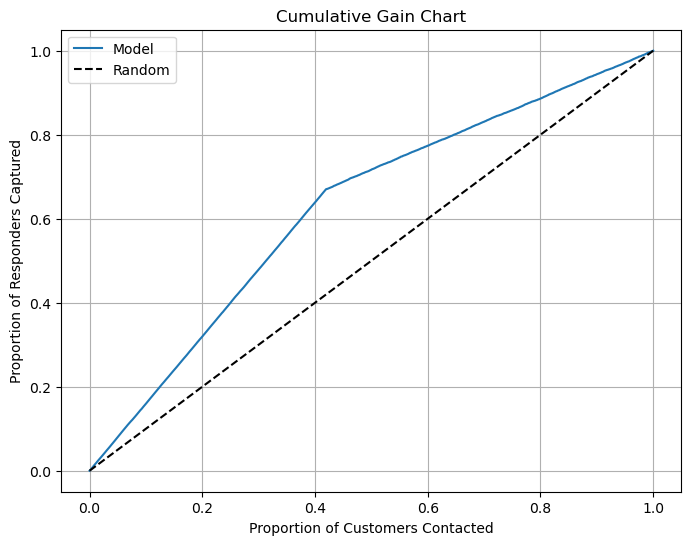

In [230]:
plt.figure(figsize=(8,6))
plt.plot(gain_df['percent_customers'], gain_df['cumulative_gain'], label='Model')
plt.plot([0,1], [0,1], 'k--', label='Random')
plt.xlabel('Proportion of Customers Contacted')
plt.ylabel('Proportion of Responders Captured')
plt.title('Cumulative Gain Chart')
plt.legend()
plt.grid(True)
plt.show()
